In [1]:
import glob
from itertools import chain
import os
import random
import zipfile
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR, CosineAnnealingLR, ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models

D:\AnaConda\envs\p-sccv\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Preparation
#### Dataset link : https://www.robots.ox.ac.uk/~vgg/data/oxbuildings/
#### Imaginile sunt descarcate de pe linkul de mai sus si salvate intr-un folder numit oxford_dataset

In [2]:
# get a list of all files in the 'oxford_dataset' directory
file_list = os.listdir('oxford_dataset')

# create a dictionary to store the images by class
classes = {}

# iterate through the list of files
for file in file_list:
  # extract the class name from the file name
    if file[-3:] == 'jpg':
        split_class_name = file.split('_')
        if len(split_class_name) == 3:
            class_name = split_class_name[0] + "_" + split_class_name[1]

        if len(split_class_name) == 2:
            class_name = split_class_name[0]

        # add the image to the list of images for the corresponding class
        file = os.path.join(class_name, file)
        file = os.path.join("data", file)
        if class_name in classes:
            classes[class_name].append(file)
        else:
            classes[class_name] = [file]

# the classes dictionary now contains the images grouped by class
for class_name in classes:
    os.makedirs(os.path.join("data", class_name))
    
import shutil
# Save each value to its corresponding folder
for class_name, values in classes.items():
    for value in values:
        file_name = value.split("\\")[2]
        src = os.path.join("oxford_dataset", file_name)
        dst = value
        try:
            shutil.move(src, dst)
            #shutil.copy(src, dst)
        except:
            pass

In [3]:
# get a list of all files in the 'oxford_dataset' directory
#file_list = os.listdir('oxford_dataset')

# create a dictionary to store the images by class
#classes = {}

# iterate through the list of files
for file in file_list:
  # extract the class name from the file name
    if file[-3:] == 'jpg':
        split_class_name = file.split('_')
        if len(split_class_name) == 3:
            class_name = split_class_name[0] + "_" + split_class_name[1]

        if len(split_class_name) == 2:
            class_name = split_class_name[0]

        # add the image to the list of images for the corresponding class
        file = os.path.join(class_name, file)
        file = os.path.join("data", file)
        if class_name in classes:
            classes[class_name].append(file)
        else:
            classes[class_name] = [file]

In [4]:
classes_array = list(classes.keys())
classes_dict = {value: position + 1 for position, value in enumerate(classes_array)}
print(classes_dict)

# Set directory to rename folders in
data_dir = 'data'

# Loop over old and new folder names
for old_name, new_name in classes_dict.items():
    # Construct old and new folder paths
    new_name = str(new_name)
    old_folder_path = os.path.join(data_dir, old_name)
    new_folder_path = os.path.join(data_dir, new_name)

    # Rename folder
    os.rename(old_folder_path, new_folder_path)

{}


In [5]:
import splitfolders

splitfolders.ratio("data", output="oxford_dataset_splited",
    seed=1337, ratio=(.8, .1, .1), group_prefix=None, move=False) # default values
# minunat✨

Copying files: 5063 files [00:37, 134.84 files/s]


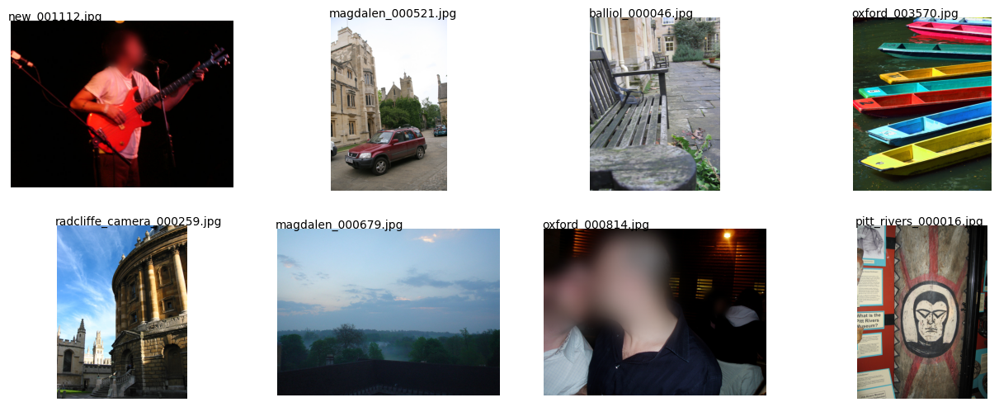

In [6]:
# visualise dataset

# Set the size of the figure
plt.figure(figsize=(16, 6))

# Get a list of all image files in the folder
#image_files = glob.glob('./oxford_dataset/*.jpg')
image_files = glob.glob('./data/*/*.jpg')

# Pick 8 random images
random_images = random.sample(image_files, 8)

# Loop through the list of random images
for i, image in enumerate(random_images):
    # Read the image file
    img = plt.imread(image)
    
    # Add the image to the plot
    plt.subplot(2, 4, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.text(-10, -5, image.split('\\')[-1])

# Show the plot
plt.show()

## Implementation

In [7]:
PATH_TRAIN = ".\\oxford_dataset_splited\\train"
PATH_VALID = ".\\oxford_dataset_splited\\valid"
PATH_TEST = ".\\oxford_dataset_splited\\test"

In [8]:
class TripletData(Dataset):
    def __init__(self, path, transforms, split="train"):
        self.path = path
        self.split = split    # train or valid
        self.cats = 17       # number of categories
        self.transforms = transforms
    
    def __getitem__(self, idx):
        # our positive class for the triplet
        idx = str(idx%self.cats + 1)
        
        # choosing our pair of positive images (im1, im2)
        positives = os.listdir(os.path.join(self.path, str(idx)))
        im1, im2 = random.sample(positives, 2)
        
        # choosing a negative class and negative image (im3)
        negative_cats = [str(x+1) for x in range(self.cats)]
        negative_cats.remove(str(idx))
        negative_cat = str(random.choice(negative_cats))
        negatives = os.listdir(os.path.join(self.path, negative_cat))
        im3 = random.choice(negatives)
        
        im1,im2,im3 = os.path.join(self.path, str(idx), im1), os.path.join(self.path, str(idx), im2), os.path.join(self.path, negative_cat, im3)
        
        im1 = self.transforms(Image.open(im1))
        im2 = self.transforms(Image.open(im2))
        im3 = self.transforms(Image.open(im3))
        
        return [im1, im2, im3]
        
    # we'll put some value that we want since there can be far too many triplets possible
    # multiples of the number of images/ number of categories is a good choice
    def __len__(self):
        return self.cats*8
    

# Transforms
train_transforms = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

val_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])


# Datasets and Dataloaders
train_data = TripletData(PATH_TRAIN, train_transforms)
val_data = TripletData(PATH_VALID, val_transforms)

train_loader = torch.utils.data.DataLoader(dataset = train_data, batch_size=32, shuffle=True)
val_loader = torch.utils.data.DataLoader(dataset = val_data, batch_size=32, shuffle=False)

In [9]:
class TripletLoss(nn.Module):
    def __init__(self, margin=1.0):
        super(TripletLoss, self).__init__()
        self.margin = margin
        
    def calc_euclidean(self, x1, x2):
        return (x1 - x2).pow(2).sum(1)
    
    # Distances in embedding space is calculated in euclidean
    def forward(self, anchor, positive, negative):
        distance_positive = self.calc_euclidean(anchor, positive)
        distance_negative = self.calc_euclidean(anchor, negative)
        losses = torch.relu(distance_positive - distance_negative + self.margin)
        return losses.mean()

In [10]:
epochs = 20
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

# Our base model
model = models.resnet18().cuda()
optimizer = optim.Adam(model.parameters(), lr=0.001)
#scheduler = ReduceLROnPlateau(optimizer, factor=0.1, patience=3)
triplet_loss = TripletLoss()

loss_history = []

# Training
for epoch in range(epochs):
    print("Training for epoch : " + str(epoch))
    model.train()
    epoch_loss = 0.0
    for data in train_loader:
        optimizer.zero_grad()
        x1,x2,x3 = data
        e1 = model(x1.to(device))
        e2 = model(x2.to(device))
        e3 = model(x3.to(device)) 
        
        loss = triplet_loss(e1,e2,e3)
        
        epoch_loss += loss
        loss.backward()
        optimizer.step()
        #scheduler.step(loss)
    loss_history.append(epoch_loss)
    print("Train Loss: {}".format(epoch_loss.item()))

Training for epoch : 0
Train Loss: 70.27820587158203
Training for epoch : 1
Train Loss: 79.62358093261719
Training for epoch : 2
Train Loss: 31.891620635986328
Training for epoch : 3
Train Loss: 11.570168495178223
Training for epoch : 4
Train Loss: 12.516475677490234
Training for epoch : 5
Train Loss: 8.45318603515625
Training for epoch : 6
Train Loss: 6.835574626922607
Training for epoch : 7
Train Loss: 5.118735313415527
Training for epoch : 8
Train Loss: 5.353031635284424
Training for epoch : 9
Train Loss: 6.129793167114258
Training for epoch : 10
Train Loss: 5.26216983795166
Training for epoch : 11
Train Loss: 4.969682693481445
Training for epoch : 12
Train Loss: 4.804343223571777
Training for epoch : 13
Train Loss: 4.640961647033691
Training for epoch : 14
Train Loss: 4.8671183586120605
Training for epoch : 15
Train Loss: 5.490889549255371
Training for epoch : 16
Train Loss: 5.235263824462891
Training for epoch : 17
Train Loss: 5.135873794555664
Training for epoch : 18
Train Loss: 

In [11]:
torch.save(model, 'model_test_2_resnet.pt')

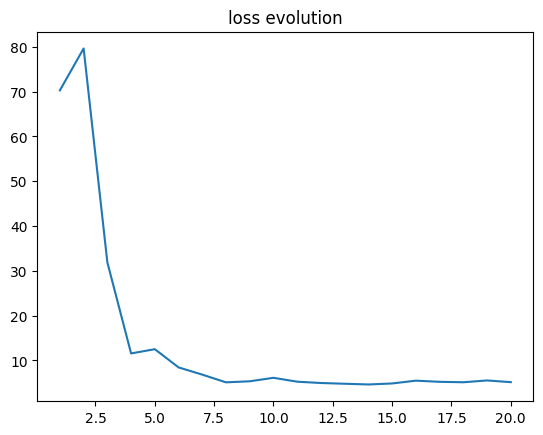

In [12]:
epochs = [x for x in range(1,21)]
double_loss_history = []
for tensor in loss_history:
    double_loss_history.append(tensor.cpu().detach().numpy())
plt.plot(epochs, double_loss_history)
plt.title('loss evolution')
plt.show()

In [13]:
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

## Search, Results

In [14]:
import faiss

In [15]:
faiss_index = faiss.IndexFlatL2(1000)   # build the index

im_indices = []
with torch.no_grad():
    for f in glob.glob(os.path.join(PATH_TRAIN, '*/*')):
        im = Image.open(f)
        im = im.resize((224,224))
        im = torch.tensor([val_transforms(im).numpy()]).cuda()
    
        preds = model(im)
        preds = np.array([preds[0].cpu().numpy()])
        faiss_index.add(preds) #add the representation to index
        im_indices.append(f)

C:\Users\iulia\AppData\Local\Temp\ipykernel_9172\3786290467.py:8: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_new.cpp:233.)
  im = torch.tensor([val_transforms(im).numpy()]).cuda()


In [16]:
len(im_indices)

4044

In [17]:
test_sol = {}

pattern = "*.jpg"
with torch.no_grad():
    for f in os.listdir(PATH_TEST):
        print(os.path.join(PATH_TEST,f))
        crt_dir = os.path.join(PATH_TEST,f)
        folder_sol = {}
        for file in glob.glob(os.path.join(crt_dir, pattern)):
            im = Image.open(file)
            im = im.resize((224,224))
            im = torch.tensor([val_transforms(im).numpy()]).cuda()

            test_embed = model(im).cpu().numpy()
            _, I = faiss_index.search(test_embed, 5)
            print("Retrieved Image: {}".format(im_indices[I[0][0]]))
            folder_sol[file] = im_indices[I[0][0]]
        test_sol[f] = folder_sol

.\oxford_dataset_splited\test\1
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001648.jpg
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000392.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000133.jpg
Retrieved Image: .\oxford_dataset_splited\train\7\hertford_000066.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003389.jpg
Retrieved Image: .\oxford_dataset_splited\train\1\all_souls_000105.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002181.jpg
Retrieved Image: .\oxford_dataset_splited\train\2\ashmolean_000088.jpg
Retrieved Image: .\oxford_dataset_splited\train\2\ashmolean_000221.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002508.jpg
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000294.jpg
Retrieved Image: .\oxford_dataset_splited\train\1\all_souls_000214.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000856.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxf

Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000277.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000467.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001082.jpg
Retrieved Image: .\oxford_dataset_splited\train\7\hertford_000010.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000141.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000563.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000088.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000301.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000295.jpg
Retrieved Image: .\oxford_dataset_splited\train\1\all_souls_000133.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000295.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_001076.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000346.jpg
.\oxford_dataset_splited\test\12
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000423.

Retrieved Image: .\oxford_dataset_splited\train\15\radcliffe_camera_000170.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001951.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001946.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003077.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002301.jpg
Retrieved Image: .\oxford_dataset_splited\train\15\radcliffe_camera_000475.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000990.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002801.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000175.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000346.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000385.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003560.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000902.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000549.jpg
Retriev

Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001123.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003329.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000278.jpg
Retrieved Image: .\oxford_dataset_splited\train\4\bodleian_000198.jpg
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000037.jpg
.\oxford_dataset_splited\test\17
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000049.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000504.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000129.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000143.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000128.jpg
Retrieved Image: .\oxford_dataset_splited\train\15\radcliffe_camera_000381.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000558.jpg
.\oxford_dataset_splited\test\2
Retrieved Image: .\oxford_dataset_splited\train\2\ashmolean_000014.jpg
Retrieved I

Retrieved Image: .\oxford_dataset_splited\train\11\new_000936.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000119.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000723.jpg
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000008.jpg
Retrieved Image: .\oxford_dataset_splited\train\6\cornmarket_000004.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000607.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_001044.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_001017.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000987.jpg
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000161.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_001088.jpg
.\oxford_dataset_splited\test\6
Retrieved Image: .\oxford_dataset_splited\train\11\new_000424.jpg
Retrieved Image: .\oxford_dataset_splited\train\14\pitt_rivers_000134.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_0022

In [18]:
import json

In [19]:
# Convert the dictionary to a JSON string
json_test_sol = json.dumps(test_sol)

# Write the JSON string to a file
with open("test_results_2.json", "w") as f:
    f.write(json_test_sol)

In [20]:
#filter all good matches
best_matches = {}
accuracy_results = {}
for k,v in test_sol.items():
    label_best_matches = {}
    accuracy_results_per_class = {}
    total_test_photos = len(v)
    corect_matches = 0
    results = {}
    for reference_image, most_similar_image in v.items():
        #print(reference_image, most_similar_image)
        most_similar_image_label = most_similar_image.split("\\")[3]
        if most_similar_image_label == k: # prezicere corecta
            label_best_matches[reference_image] = most_similar_image
            corect_matches += 1
        #print(reference_image, most_similar_image_label)
        results['corect_match'] = corect_matches
        results['missed_match'] = total_test_photos - corect_matches
        results['accuracy'] = float(corect_matches / total_test_photos)
    accuracy_results[k] = results
    best_matches[k] = label_best_matches

In [21]:
class_id_arr = []
class_accuracy = []
for class_id, results in accuracy_results.items():
    class_id_arr.append(class_id)
    class_accuracy.append(results['accuracy'])


In [22]:
color_array=["red", "green", "blue", "orange", "purple", "pink", "yellow", "brown", "gray", "black", "darkorange", "cyan", "magenta", "navy", "maroon", "turquoise", "olive"]
classes_legend = {'all_souls': 1, 'ashmolean': 2, 'balliol': 3, 'bodleian': 4, 'christ_church': 5, 'cornmarket': 6, 'hertford': 7, 'jesus': 8, 'keble': 9, 'magdalen': 10, 'new': 11, 'oriel': 12, 'oxford': 13, 'pitt_rivers': 14, 'radcliffe_camera': 15, 'trinity': 16, 'worcester': 17}
swapped_d = dict(zip(classes_legend.values(), classes_legend.keys()))
string_keys_swapped_d = {str(k): v for k, v in swapped_d.items()}
legend = []
for class_id in class_id_arr:
    legend.append(string_keys_swapped_d[class_id])

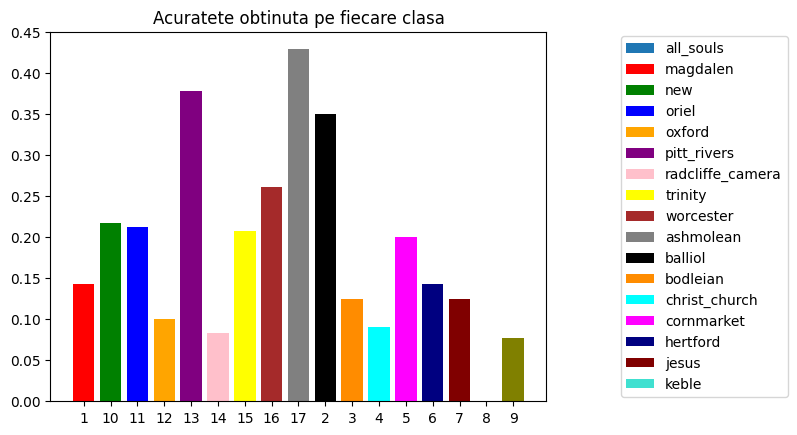

In [23]:
plt.figure
plt.bar(class_id_arr, class_accuracy,)
for x,y,c,lb in zip(class_id_arr,class_accuracy,color_array,legend):
    plt.bar(x, y, color=c,label=lb)
plt.title('Acuratete obtinuta pe fiecare clasa')
plt.legend(legend,bbox_to_anchor=[1.5, 0.5], loc='center right')
plt.show()

C:\Users\iulia\AppData\Local\Temp\ipykernel_9172\1527860164.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2)


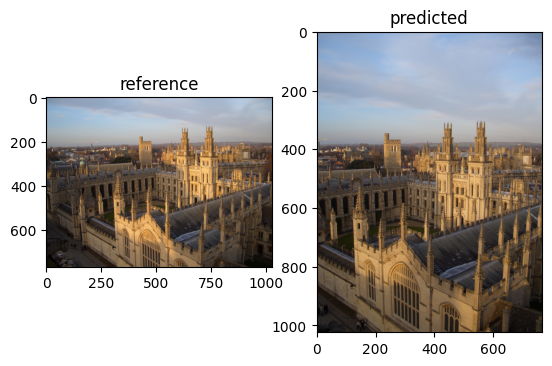

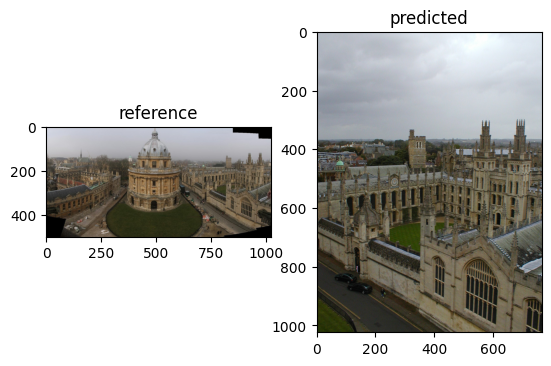

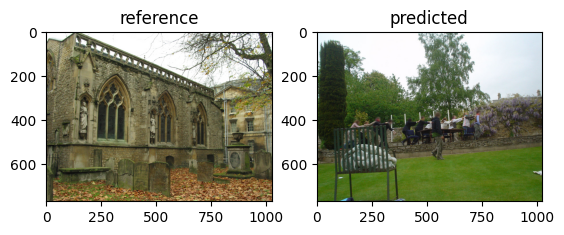

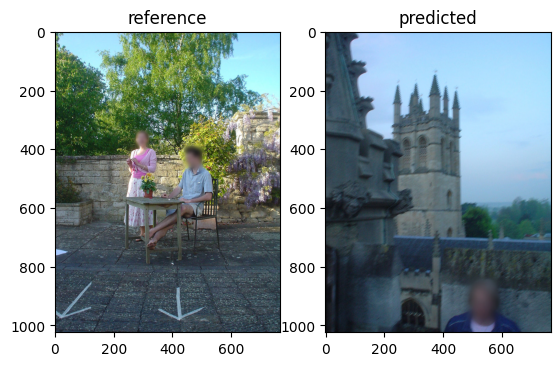

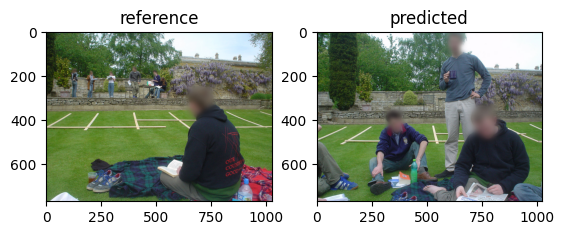

...

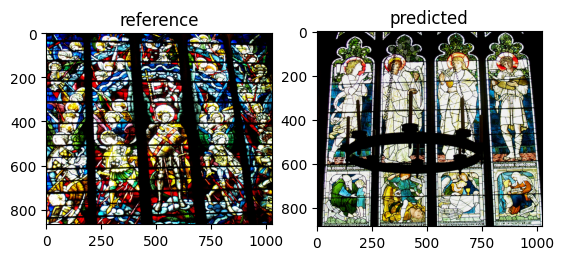

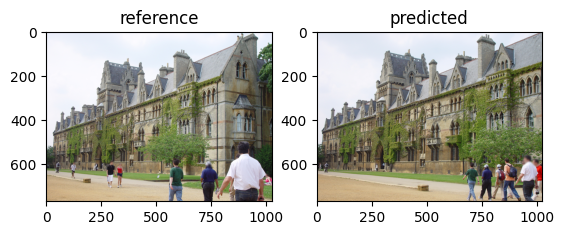

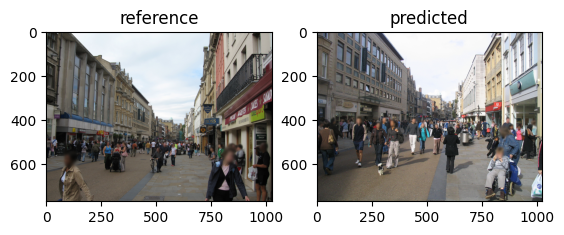

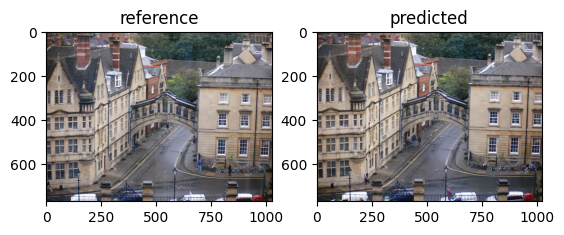

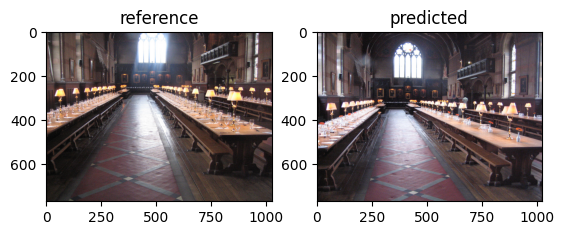

In [24]:
#VISUALISE BEST MATCHES

for k,v in best_matches.items():
    for ref, pred in v.items():
        # Create a figure with two subplots side by side
        fig, (ax1, ax2) = plt.subplots(1, 2)
        
        image1 = plt.imread(ref)
        image2 = plt.imread(pred)

        # Show the first image on the left subplot
        ax1.imshow(image1)
        ax1.set_title("reference")

        # Show the second image on the right subplot
        ax2.imshow(image2)
        ax2.set_title("predicted")

# Show the figure
plt.show()

In [25]:
def euclidean_distance(img1, img2):
    return np.sqrt(np.sum(np.power(img1 - img2, 2)))

In [26]:
from skimage import color

def window_processing(roi, current_value, mask, window_size):

    roi = (roi > current_value).astype(int)
    roi[window_size//2, window_size//2] = 0
    
    return np.sum(roi * mask)


'''
def lbp(img, window_size, mask):
    
    img = color.rgb2gray(img)
    h = img.shape[0]
    w = img.shape[1]
    new_img = np.zeros((h, w))
    
    for i in range(window_size, h - window_size):
        for j in range(window_size, w - window_size):
            
            roi = img[i - window_size//2 : i + window_size//2 +1, \
                      j - window_size//2 : j + window_size//2 + 1 ]
                
            current_value = img[i][j]
            new_img[i][j] = window_processing(roi, current_value, mask, window_size)
    
    return new_img
'''

#time optimized lbp
def lbp(img, window_size, mask):
    
    img = color.rgb2gray(img)
    h,w=img.shape
    
    I1 = img[1:h-1,1:w-1]<img[0:h-2,0:w-2]
    I2 = img[1:h-1,1:w-1]<img[0:h-2,1:w-1]
    I3 = img[1:h-1,1:w-1]<img[0:h-2,2:w]
    
    I4 = img[1:h-1,1:w-1]<img[1:h-1,2:w]
    I5 = img[1:h-1,1:w-1]<img[2:h,2:w]
    
    I6 = img[1:h-1,1:w-1]<img[2:h,1:w-1]
    I7 = img[1:h-1,1:w-1]<img[2:h,0:w-2]
    I8 = img[1:h-1,1:w-1]<img[1:h-1,0:w-2]
    
    I1 = I1*(2**7)
    I2= I2*(2**6)
    I3 = I3*(2**5)
    I4= I4*(2**4)
    I5= I5*(2**3)
    I6 = I6*(2**2)
    I7 = I7*2
    I8= I8*1

    new_img = I1+I2+I3+I4+I5+I6+I7+I8
    
    return new_img

In [27]:
def compute_lbp_on_single_image(image_path):
    '''
    input: [str] image_path
    oruput: [numpy_array] lbp_image
    '''
    mask = np.array([[7,6,5], [0,0,4], [1,2,3]])
    mask = pow(2, mask)
    
    new_img = Image.open(image_path)
    new_img = new_img.resize((384, 256))
    new_img = np.array(new_img)
    new_img = lbp(new_img, 3, mask)
    #new_img = new_img.astype(np.uint8)
    
    return new_img

In [28]:
import time
from skimage.io import imsave

train_image_files = glob.glob('./oxford_dataset_splited/train/*/*.jpg')

#save lbp data
start = time.time()
for i in range(17):
    if not os.path.exists(os.path.join("data_lbp", str(i+1))):
        os.makedirs(os.path.join("data_lbp", str(i+1)))

current_class = 1
counter_class = 0
no_samples_in_class = 40
for e in train_image_files:
    #get only the first 50 samples from every class
    if int(e.split('\\')[1]) == 10 and (int(e[-8:-4])) == 0:
        current_class = 10
        counter_class = 0
    elif int(e.split('\\')[1]) == 2 and (int(e[-8:-4])) == 0:
        current_class = 2
        counter_class = 0
    elif int(e.split('\\')[1]) == current_class + 1:
        current_class += 1
        counter_class = 0
    
    if int(e.split('\\')[1]) == current_class and counter_class < no_samples_in_class:
        print(e)
        #print(int(e.split('\\')[1]))
        new_location = e[:2] + 'data_lbp' + e[30:]

        #img_lbp = lbp(plt.imread(e), 3, mask)
        img_lbp = compute_lbp_on_single_image(e)

        #img = Image.fromarray(img_lbp)
        #img = img.convert('RGB')
        #img.save(new_location)
        imsave(new_location, img_lbp.astype(np.uint8))
        
        counter_class += 1
    #else:
        #do nothing
        #print(int(e[-7:-4]))

print()
print(time.time() - start)



./oxford_dataset_splited/train\1\all_souls_000000.jpg
./oxford_dataset_splited/train\1\all_souls_000001.jpg
./oxford_dataset_splited/train\1\all_souls_000002.jpg
./oxford_dataset_splited/train\1\all_souls_000003.jpg
./oxford_dataset_splited/train\1\all_souls_000005.jpg
./oxford_dataset_splited/train\1\all_souls_000006.jpg
./oxford_dataset_splited/train\1\all_souls_000007.jpg
./oxford_dataset_splited/train\1\all_souls_000008.jpg
./oxford_dataset_splited/train\1\all_souls_000011.jpg
./oxford_dataset_splited/train\1\all_souls_000012.jpg
./oxford_dataset_splited/train\1\all_souls_000013.jpg
./oxford_dataset_splited/train\1\all_souls_000014.jpg
./oxford_dataset_splited/train\1\all_souls_000016.jpg
./oxford_dataset_splited/train\1\all_souls_000017.jpg
./oxford_dataset_splited/train\1\all_souls_000018.jpg
./oxford_dataset_splited/train\1\all_souls_000019.jpg
./oxford_dataset_splited/train\1\all_souls_000020.jpg
./oxford_dataset_splited/train\1\all_souls_000021.jpg
./oxford_dataset_splited/tra

./oxford_dataset_splited/train\12\oriel_000058.jpg
./oxford_dataset_splited/train\13\oxford_000007.jpg
./oxford_dataset_splited/train\13\oxford_000008.jpg
./oxford_dataset_splited/train\13\oxford_000009.jpg
./oxford_dataset_splited/train\13\oxford_000010.jpg
./oxford_dataset_splited/train\13\oxford_000012.jpg
./oxford_dataset_splited/train\13\oxford_000013.jpg
./oxford_dataset_splited/train\13\oxford_000014.jpg
./oxford_dataset_splited/train\13\oxford_000015.jpg
./oxford_dataset_splited/train\13\oxford_000016.jpg
./oxford_dataset_splited/train\13\oxford_000017.jpg
./oxford_dataset_splited/train\13\oxford_000018.jpg
./oxford_dataset_splited/train\13\oxford_000019.jpg
./oxford_dataset_splited/train\13\oxford_000022.jpg
./oxford_dataset_splited/train\13\oxford_000023.jpg
./oxford_dataset_splited/train\13\oxford_000026.jpg
./oxford_dataset_splited/train\13\oxford_000029.jpg
./oxford_dataset_splited/train\13\oxford_000030.jpg
./oxford_dataset_splited/train\13\oxford_000031.jpg
./oxford_data

./oxford_dataset_splited/train\16\trinity_000045.jpg
./oxford_dataset_splited/train\16\trinity_000046.jpg
./oxford_dataset_splited/train\16\trinity_000047.jpg
./oxford_dataset_splited/train\16\trinity_000049.jpg
./oxford_dataset_splited/train\16\trinity_000050.jpg
./oxford_dataset_splited/train\16\trinity_000051.jpg
./oxford_dataset_splited/train\16\trinity_000052.jpg
./oxford_dataset_splited/train\16\trinity_000053.jpg
./oxford_dataset_splited/train\16\trinity_000055.jpg
./oxford_dataset_splited/train\16\trinity_000056.jpg
./oxford_dataset_splited/train\16\trinity_000063.jpg
./oxford_dataset_splited/train\16\trinity_000064.jpg
./oxford_dataset_splited/train\17\worcester_000001.jpg
./oxford_dataset_splited/train\17\worcester_000053.jpg
./oxford_dataset_splited/train\17\worcester_000054.jpg
./oxford_dataset_splited/train\17\worcester_000055.jpg
./oxford_dataset_splited/train\17\worcester_000056.jpg
./oxford_dataset_splited/train\17\worcester_000057.jpg
./oxford_dataset_splited/train\17\

./oxford_dataset_splited/train\4\bodleian_000052.jpg
./oxford_dataset_splited/train\4\bodleian_000058.jpg
./oxford_dataset_splited/train\4\bodleian_000060.jpg
./oxford_dataset_splited/train\4\bodleian_000062.jpg
./oxford_dataset_splited/train\4\bodleian_000067.jpg
./oxford_dataset_splited/train\4\bodleian_000069.jpg
./oxford_dataset_splited/train\4\bodleian_000070.jpg
./oxford_dataset_splited/train\4\bodleian_000072.jpg
./oxford_dataset_splited/train\4\bodleian_000073.jpg
./oxford_dataset_splited/train\4\bodleian_000076.jpg
./oxford_dataset_splited/train\4\bodleian_000077.jpg
./oxford_dataset_splited/train\4\bodleian_000081.jpg
./oxford_dataset_splited/train\4\bodleian_000083.jpg
./oxford_dataset_splited/train\4\bodleian_000084.jpg
./oxford_dataset_splited/train\4\bodleian_000090.jpg
./oxford_dataset_splited/train\4\bodleian_000094.jpg
./oxford_dataset_splited/train\5\christ_church_000000.jpg
./oxford_dataset_splited/train\5\christ_church_000001.jpg
./oxford_dataset_splited/train\5\chr

./oxford_dataset_splited/train\8\jesus_000038.jpg
./oxford_dataset_splited/train\8\jesus_000040.jpg
./oxford_dataset_splited/train\8\jesus_000041.jpg
./oxford_dataset_splited/train\8\jesus_000042.jpg
./oxford_dataset_splited/train\8\jesus_000043.jpg
./oxford_dataset_splited/train\8\jesus_000045.jpg
./oxford_dataset_splited/train\8\jesus_000047.jpg
./oxford_dataset_splited/train\8\jesus_000051.jpg
./oxford_dataset_splited/train\8\jesus_000053.jpg
./oxford_dataset_splited/train\8\jesus_000054.jpg
./oxford_dataset_splited/train\8\jesus_000056.jpg
./oxford_dataset_splited/train\8\jesus_000061.jpg
./oxford_dataset_splited/train\8\jesus_000062.jpg
./oxford_dataset_splited/train\8\jesus_000071.jpg
./oxford_dataset_splited/train\8\jesus_000083.jpg
./oxford_dataset_splited/train\8\jesus_000099.jpg
./oxford_dataset_splited/train\8\jesus_000100.jpg
./oxford_dataset_splited/train\8\jesus_000113.jpg
./oxford_dataset_splited/train\8\jesus_000114.jpg
./oxford_dataset_splited/train\8\jesus_000115.jpg


C:\Users\iulia\AppData\Local\Temp\ipykernel_9172\1217502336.py:2: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(np.sum(np.power(img1 - img2, 2)))


./data\1\all_souls_000000.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000035.jpg
./data\17\worcester_000063.jpg
./data\14\pitt_rivers_000017.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000035.jpg
./data\3\balliol_000035.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000016.jpg
./data\3\balliol_000035.jpg
./data\9\keble_000034.jpg
./data\16\trinity_000028.jpg
./data\12\oriel_000051.jpg


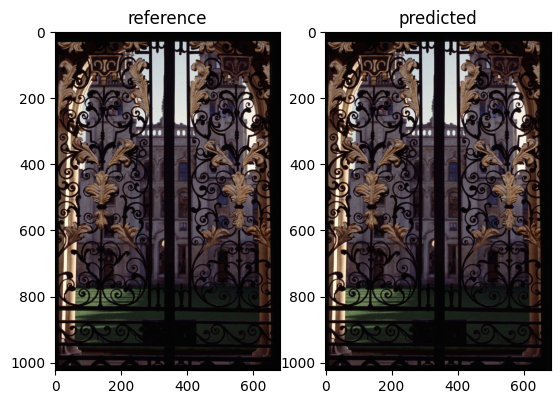

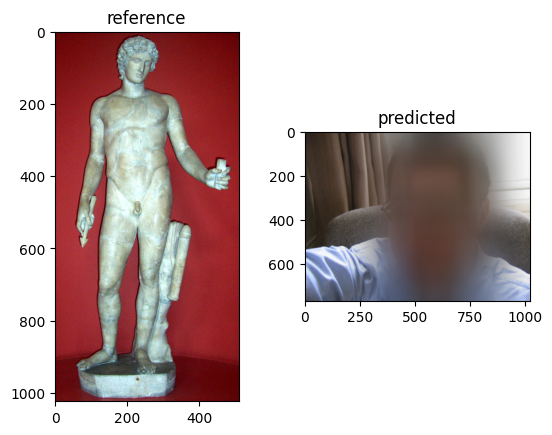

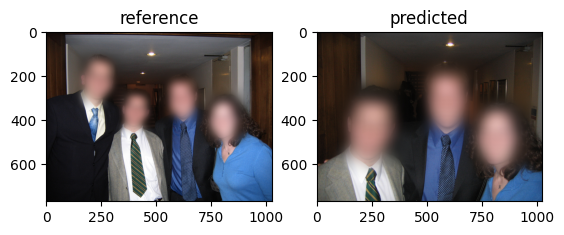

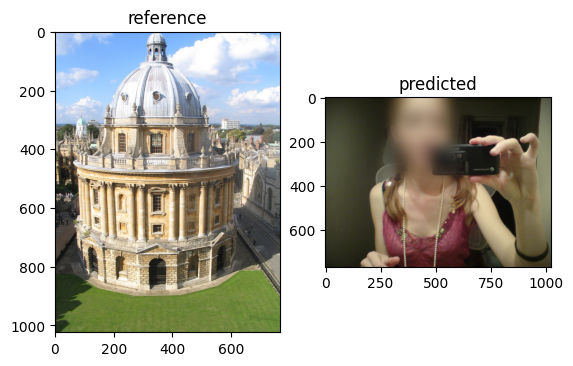

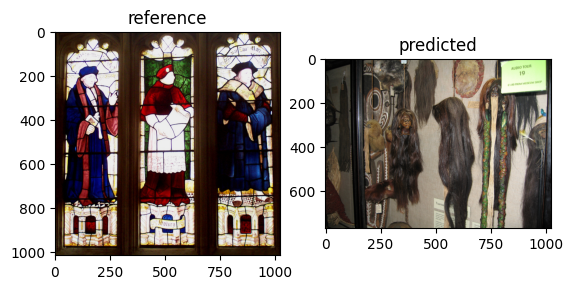

...

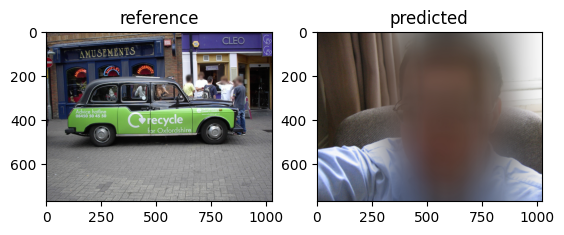

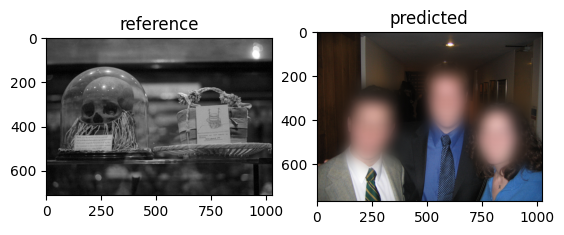

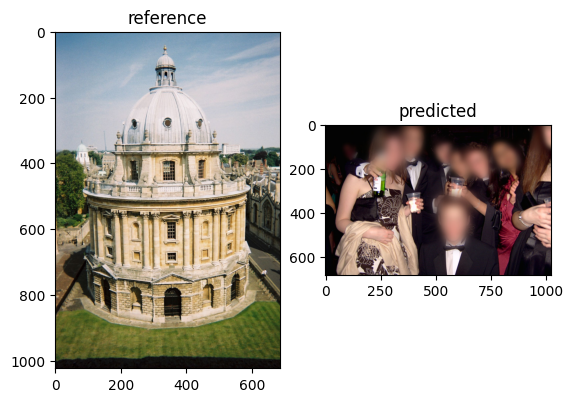

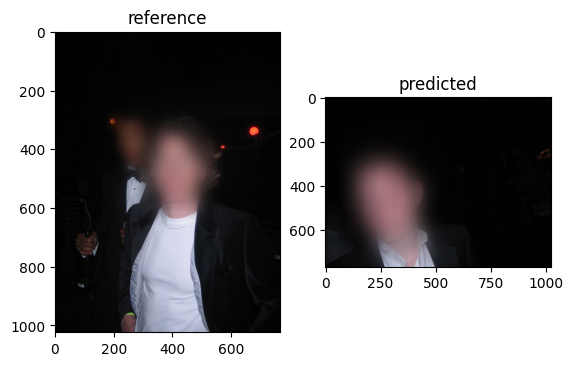

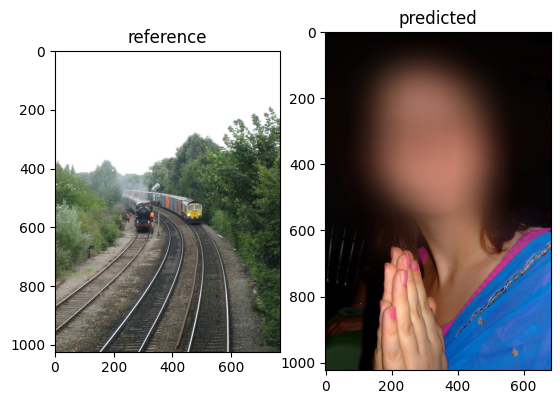

In [29]:
#VISUALISE LBP METHOD RESULTS FOR EVERY CLASS
lbp_image_files = glob.glob('./data_lbp/*/*.jpg')

test_images = ['./oxford_dataset_splited/train\\1\\all_souls_000000.jpg', \
               './oxford_dataset_splited/test\\2\\ashmolean_000203.jpg', \
               './oxford_dataset_splited/test\\3\\balliol_000116.jpg', \
               './oxford_dataset_splited/test\\4\\bodleian_000106.jpg', \
               './oxford_dataset_splited/test\\5\\christ_church_000316.jpg', \
               './oxford_dataset_splited/test\\6\\cornmarket_000097.jpg', \
               './oxford_dataset_splited/test\\7\\hertford_000103.jpg', \
               './oxford_dataset_splited/test\\8\\jesus_000035.jpg', \
               './oxford_dataset_splited/test\\9\\keble_000066.jpg', \
               './oxford_dataset_splited/test\\10\\magdalen_001101.jpg', \
               './oxford_dataset_splited/test\\11\\new_000448.jpg', \
               './oxford_dataset_splited/test\\12\\oriel_000050.jpg', \
               './oxford_dataset_splited/test\\13\\oxford_000184.jpg', \
               './oxford_dataset_splited/test\\14\\pitt_rivers_000031.jpg', \
               './oxford_dataset_splited/test\\15\\radcliffe_camera_000021.jpg', \
               './oxford_dataset_splited/test\\16\\trinity_000038.jpg', \
               './oxford_dataset_splited/test\\17\\worcester_000135.jpg', \
              ]



# Create a figure with two subplots side by side
for ref in test_images:
    
    new_img = compute_lbp_on_single_image(ref)

    #get min euclidean distance from database
    ed_list = []
    for e in lbp_image_files:
        img_database = plt.imread(e)
        #img_database = color.rgb2gray(img_database)

        ed_list.append(euclidean_distance(img_database, new_img))

    minimum = min(ed_list)
    min_index = ed_list.index(minimum)
    pred_lbp = lbp_image_files[min_index]
    pred = pred_lbp[:6] + pred_lbp[10:]
    #print(minimum)
    #print(min_index)
    print(pred)

    fig, (ax1, ax2) = plt.subplots(1, 2)

    image1 = plt.imread(ref)
    image2 = plt.imread(pred)

    # Show the first image on the left subplot
    ax1.imshow(image1)
    ax1.set_title("reference")

    # Show the second image on the right subplot
    ax2.imshow(image2)
    ax2.set_title("predicted")
    

C:\Users\iulia\AppData\Local\Temp\ipykernel_9172\1217502336.py:2: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(np.sum(np.power(img1 - img2, 2)))


11
14
14
16
16
16
16
16
17
3
3
3
3
3
3
3
3
8
9
9
[0. 0. 8. 0. 0. 0. 0. 1. 2. 0. 1. 0. 0. 2. 0. 5. 1.]

634.6491079330444


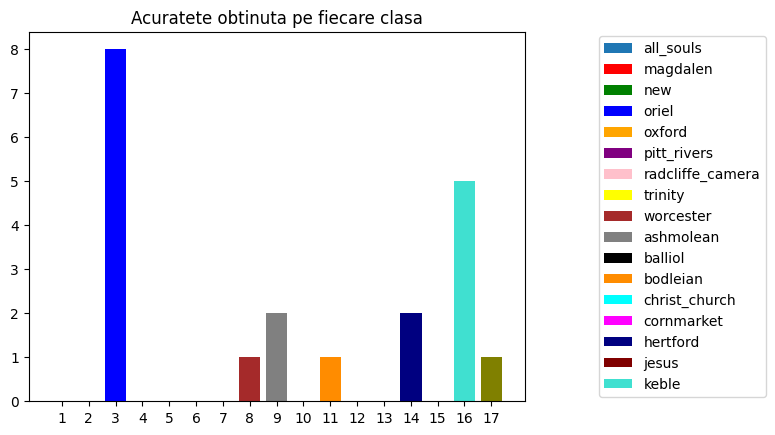

In [31]:
lbp_image_files = glob.glob('./data_lbp/*/*.jpg')
test_image_files = glob.glob('./oxford_dataset_splited/test/*/*.jpg')

start = time.time()

class_id_arr = np.arange(1,18).astype(np.uint8)
class_accuracy = np.zeros(17)
for test_e in test_image_files:
    new_img = compute_lbp_on_single_image(test_e)

    #get min euclidean distance from database
    ed_list = []
    for e in lbp_image_files:
        img_database = plt.imread(e)
        #img_database = color.rgb2gray(img_database)

        ed_list.append(euclidean_distance(img_database, new_img))

    minimum = min(ed_list)
    min_index = ed_list.index(minimum)
    pred_lbp = lbp_image_files[min_index]
    pred = pred_lbp[:6] + pred_lbp[10:]
    
    #print(pred.split('\\')[1])
    #print(test_e.split('\\')[1])
    
    if int(pred.split('\\')[1]) == int(test_e.split('\\')[1]):
        class_accuracy[int(pred.split('\\')[1]) - 1] += 1
        print(test_e.split('\\')[1])
    
print(class_accuracy)
print()
print(time.time() - start)

plt.figure
plt.bar(class_id_arr, class_accuracy,)
for x,y,c,lb in zip(class_id_arr,class_accuracy,color_array,legend):
    plt.bar(x, y, color=c,label=lb)
plt.xticks(ticks=class_id_arr)
plt.title('Acuratete obtinuta pe fiecare clasa')
plt.legend(legend,bbox_to_anchor=[1.5, 0.5], loc='center right')
plt.show()
